# Style-Transfer and Texture Synthesis

In this project, the goal is to reimplement certain aspects of two papers for style transfer and texture synthesis.

## Sisi Qu 
## KAUST ID: 169001

# Image Style Transfer Using Convolutional Neural Networks [1]

The goal of the approach described in [1] is to transfer the style of a style image $\vec{a}$ to a content image $\vec{p}$ by gradually applying changes to a target image $\vec{x}$ that is initially showing white noise (or for performance reasons the content image $\vec{p}$) such that $\vec{x}$ converges to an image that shows the content of $\vec{p}$ (e.g. KAUST) in the style of $\vec{a}$ (similar colors, brush strokes etc.) (cf. figure below) Details about the method are provided in Appendix A.

<center><img src='img/overview.jpg' width=80% /></center>

## Library imports and definition of some helper functions (do not change anything)

In [1]:
# import all needed resources
%matplotlib inline

from PIL import Image
from io import BytesIO
import matplotlib.pyplot as plt
import numpy as np
import time

import torch
import torch.nn as nn
import torch.optim as optim
import requests
from torchvision import transforms, models

In [2]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [3]:
def load_image(img_path, max_size = 400, shape = None):
    
    ''' Load and downscale an image if the shorter side is longer than <max_size> px '''
    
    if "http" in img_path:
        response = requests.get(img_path)
        image = Image.open(BytesIO(response.content)).convert('RGB')
    else:
        image = Image.open(img_path).convert('RGB')
    
    if min(image.size) > max_size:
        size = max_size
    else:
        size = min(image.size)
    
    if shape is not None:
        size = shape
    
    in_transform = transforms.Compose([
                        transforms.Resize(size),
                        transforms.ToTensor(),
                        transforms.Normalize((0.485, 0.456, 0.406), 
                                             (0.229, 0.224, 0.225))])

    # discard alpha channel (:3) and append the batch dimension (unsqueeze(0))
    image = in_transform(image)[:3,:,:].unsqueeze(0)
    
    return image

In [4]:
# helper function for un-normalizing an image 
# and converting it from a Tensor image to a NumPy image for display
def im_convert(tensor):
    """ Convert a PyTorch tensor to a NumPy image. """
    
    image = tensor.to("cpu").clone().detach()
    image = image.numpy().squeeze()
    image = image.transpose(1,2,0)
    image = image * np.array((0.229, 0.224, 0.225)) + np.array((0.485, 0.456, 0.406))
    image = image.clip(0, 1)

    return image

In [5]:
''' Define and load corresponding content/style pairs '''

content_files = ['kaust', 'tesla', 'hamilton', 'mandela']
style_files = ['starry_night', 'jesuiten', 'scream', 'ben_passmore']
ref_vgg_files = ['vgg0_ref', 'vgg1_ref', 'vgg2_ref', 'vgg3_ref']
ref_resnet_files = ['res0_ref', 'res1_ref', 'res2_ref', 'res3_ref']

# load in content and style images
content = [load_image('img/content/' + c + '.jpg').to(device) for c in content_files]

# Resize style images to match corresponding content, makes code easier
style = [load_image('img/style/' + s + '.jpg', shape=content[n].shape[-2:]).to(device) for n, s in enumerate(style_files)]

ref_vgg =  [load_image('img/ref/' + c + '.jpg').to(device) for c in ref_vgg_files]
ref_res =  [load_image('img/ref/' + c + '.jpg').to(device) for c in ref_resnet_files]

# Create Target image and prepare it for change (requires_grad_(True))
# Starting with the content image and applying the style is usually faster than starting from a random image

# Target Image = Content Image
target = [c.clone().requires_grad_(True).to(device) for c in content]

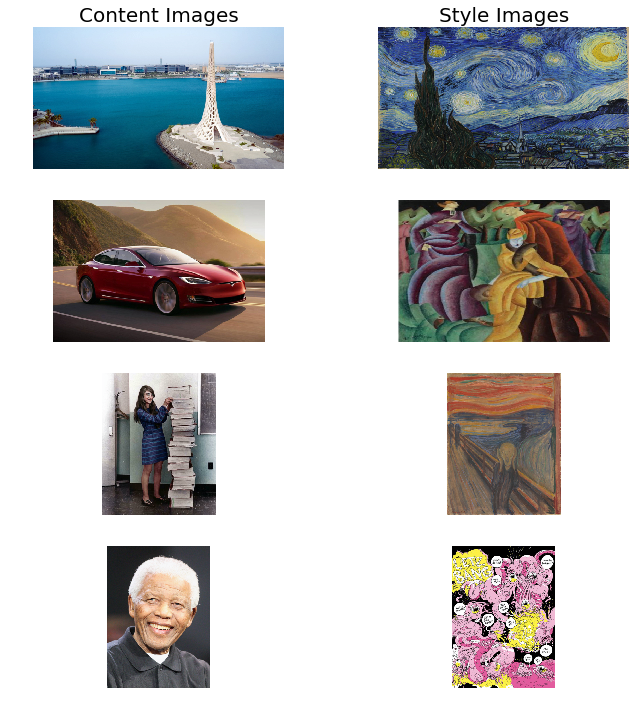

In [6]:
# display the images
num_pairs = len(content)
fig, axs = plt.subplots(num_pairs, 2, figsize=(10, 10))

axs[0, 0].set_title('Content Images', fontsize=20)
axs[0, 1].set_title('Style Images', fontsize=20)
#axs[0, 2].set_title('Target Images', fontsize=20)

# content and correspoinding style image side-by-side
for row in range(0, num_pairs):
        axs[row, 0].imshow(im_convert(content[row]))
        axs[row, 1].imshow(im_convert(style[row]))
        # axs[row, 2].imshow(im_convert(target[row]))

        for col in range(0, 2):
            axs[row, col].axis('off')
        
fig.tight_layout()
plt.show()

In [7]:
def get_features(image, model, layers):
    # Run an image forward through a model and get the features for a set of layers.
        
    features = {}
    x = image
    # model._modules is a dictionary holding each module in the model
    for name, layer in model._modules.items():
        x = layer(x)
        if name in layers:
            features[layers[name]] = x
            
    return features

## Task 1: Calculate the $d \times d$ gram matrix corresponding to a $1 \times d \times h \times w$ tensor (10 points)

As described in [1], the style of an image can be represented by the Gram matrix of a layer consisting of a set of features maps.

In [8]:
def gram_matrix(tensor):
    """ Calculate the Gram Matrix of a given tensor 
        Gram Matrix: https://en.wikipedia.org/wiki/Gramian_matrix
    """
    
    # TODO Task 1: Implement the computation of the Gram Matrix
    
    ## get the batch_size, depth, height, and width of the Tensor
    b, d, h, w = tensor.shape

    ## reshape it, so we're multiplying the features for each channel
    tensor =  tensor.view(b,d,-1)
    
    ## calculate the gram matrix
    gram = torch.bmm(tensor, tensor.transpose(1,2))
    
    return gram

## Task 2: Complete the Training Function (15 points)

In order to complete this task, you might want to refer to the paper [1] and to the Appendix A. Note that the equations in Appendix A slightly differ from the originals in the paper. However, we highly recommend the equations in Appendix A since the equations in the paper seem to be inconsistent to the original implementation of the authors and are obviously missing normalization.

In [9]:
def run_model(model, layers, target, content_features, style_grams, content_layer, style_weights, content_weight = 1, style_weight = 1.0e12, steps = 5000, lr = 0.003):
    
    # for displaying the loss values, intermittently
    show_every = 500

    # iteration hyperparameters
    optimizer = optim.Adam([target], lr=lr)
    
    # Values of the learning curve
    learning_curve = np.zeros(steps)
    
    print(learning_curve.shape)

    start = time.time()

    for ii in range(1, steps+1):

        
        ## TODO Task 2: get the features from the target image w.r.t. the provided model and the required layers
        target_features = get_features(target, model, layers)
        
        ## TODO Task 2: calculate the content loss (refer to Appendix A for details about the formula)
        content_loss = torch.nn.functional.mse_loss(target_features[content_layer], content_features[content_layer])


        # the style loss
        # initialize the style loss to 0
        style_loss = 0
        
        # then add to it for each layer's gram matrix loss
        for layer in style_weights:

            target_feature = target_features[layer]

            _, d, h, w = target_feature.shape

            
            ## TODO Task 2: Calculate the target gram matrix
            target_gram = gram_matrix(target_feature)

            ## TODO Task 2: get the "style" style representation
            style_gram = style_grams[layer]

            ## TODO Task 2: Calculate the style loss for one layer, weighted appropriately (again, refer to Appendix A for details)
            layer_style_loss = style_weights[layer] * torch.nn.functional.mse_loss(target_gram, style_gram) / (h * w)**2

            
            # add to the style loss
            style_loss +=  layer_style_loss 

            
        # TODO Task 2: calculate the *total* loss
        total_loss = content_weight * content_loss + style_weight * style_loss


        learning_curve[ii - 1] = total_loss

        # update your target image
        optimizer.zero_grad()
        total_loss.backward()
        optimizer.step()

        # display intermediate images and print the loss
        if  ii % show_every == 0:
            print('Total loss: ', total_loss.item())
            print('Weighted Content loss: ', content_weight * content_loss.item())
            print('Weighted Style loss: ', style_weight * style_loss.item())

            end = time.time()
            print('Time [s]: ', (end - start))
            plt.imshow(im_convert(target))
            plt.show()

    end = time.time()
    print('Total Time [s]: ', (end - start))
    
    return [target, learning_curve]

## VGG Network
We want to use the VGG-19 network for feature extraction first, since it was also suggestend by the authors of [1].

In [10]:
# get the "features" portion of VGG19 (we will not need the "classifier" portion)
vgg = models.vgg19(pretrained=True).features.to(device)

# freeze all VGG parameters since we're only optimizing the target image
for param in vgg.parameters():
    param.requires_grad_(False)

In [11]:
# print out VGG19 structure so you can see the numbers of various layers
print(vgg)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace)
  (18): MaxPool2d(kernel_size=2, stride=2, padding=0, 

## Task 3: Complete the mapping from VGG layer numbers to layer names (6 points)

Refer to the paper [1] to identify the layers that are suitable for content and style representation and complete the dictionary below that maps from layer numbers to layer names.
You may also want to print the VGG network using the print command above to see the layer numbers together with the corresponding layers.

In [12]:
## TODO Task 3: Complete mapping layer names of PyTorch's VGGNet to names from the paper
## Need the layers for the content and style representations of an image

# definition of all the layers needed from VGG net
layers_vgg = {'0': 'conv1_1',
             '5': 'conv2_1',
             '10': 'conv3_1',
             '19': 'conv4_1',
             '28': 'conv5_1',
             '21': 'conv4_2'}


In [13]:
# get content and style features only once before training
content_features_vgg = [get_features(c, vgg, layers_vgg) for c in content]
style_features_vgg = [get_features(s, vgg, layers_vgg) for s in style]

# calculate the gram matrices for each layer of our style representation
#style_grams = {layer: gram_matrix(style_features[layer]) for layer in style_features}
style_grams_vgg = [{layer: gram_matrix(s[layer]) for layer in s} for s in style_features_vgg]

In [14]:
# Weights for VGG net
# weights for each style layer 
# weighting earlier layers more will result in *larger* style artifacts
# notice we are excluding `conv4_2` which is used for content representation

style_weights_vgg = {'conv1_1': 1.,
                     'conv2_1': 0.8,
                     'conv3_1': 0.5,
                     'conv4_1': 0.3,
                     'conv5_1': 0.1}

## Task 4: Styler Transfer using the VGG network (12 points - 4 examples, 3 points each)

Experiment with different weights for style (1.0e3, 1.0e6, 1.0e9, 1.0e12), different numbers of steps (e.g. 500, 1000, 2000) and different learning rates (e.g. 0.1, 0.01, 0.001) to find a set of parameters with which you can create a stylized image that looks similar to the provided reference solution as fast / efficient as possible. Plot the learning curve and put both the learning curvevs and training times together with the final result to your final report.

In [17]:
# Target Image = Content Image (Reload original images)
target = [c.clone().requires_grad_(True).to(device) for c in content]

(2000,)
Total loss:  33691492.0
Weighted Content loss:  8.605671882629395
Weighted Style loss:  33691484.48109627
Time [s]:  59.070061922073364


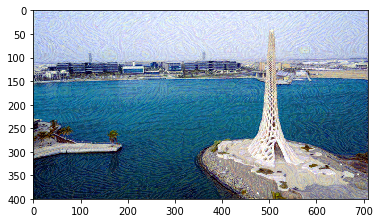

Total loss:  13524889.0
Weighted Content loss:  8.956299781799316
Weighted Style loss:  13524879.701435566
Time [s]:  140.9925398826599


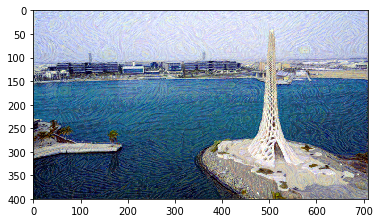

Total loss:  8625119.0
Weighted Content loss:  9.120864868164062
Weighted Style loss:  8625109.679996967
Time [s]:  222.89563989639282


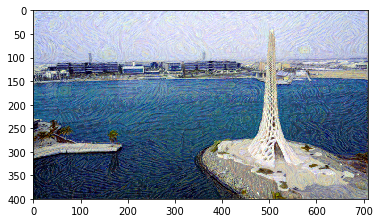

Total loss:  6773556.0
Weighted Content loss:  9.250921249389648
Weighted Style loss:  6773546.33808136
Time [s]:  304.7218508720398


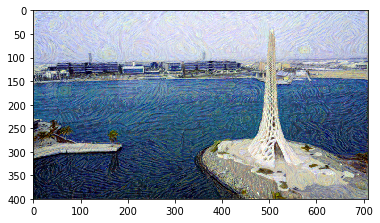

Total Time [s]:  304.87654089927673


In [18]:
# TODO Task 4: Style Transfer for content[0] and style[0] stored in target[0]
[s_0, slc_0] = run_model(vgg, layers_vgg, target[0], content_features_vgg[0], style_grams_vgg[0], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e9, steps = 2000, lr = 0.01)


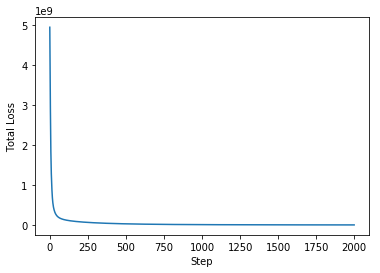

In [19]:
plt.plot(slc_0)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

(2000,)
Total loss:  15982396.0
Weighted Content loss:  8.081881523132324
Weighted Style loss:  15982387.587428093
Time [s]:  72.82722783088684


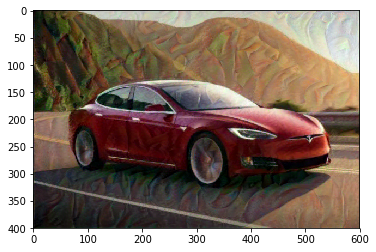

Total loss:  9959721.0
Weighted Content loss:  8.376898765563965
Weighted Style loss:  9959712.624549866
Time [s]:  144.4633984565735


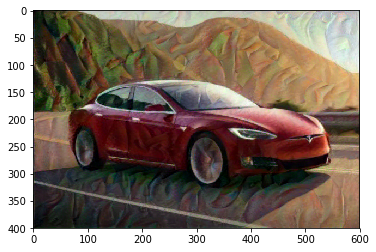

Total loss:  7590080.0
Weighted Content loss:  8.546707153320312
Weighted Style loss:  7590071.298182011
Time [s]:  216.58961939811707


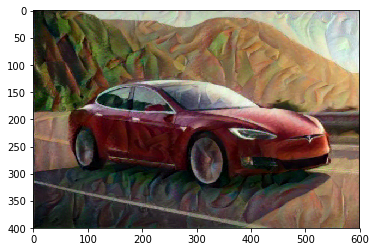

Total loss:  6530990.0
Weighted Content loss:  8.66930866241455
Weighted Style loss:  6530981.510877609
Time [s]:  287.64477372169495


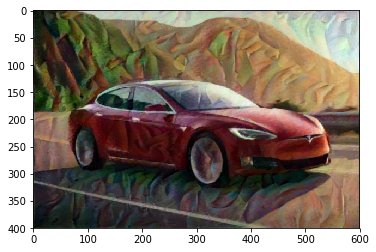

Total Time [s]:  287.8125424385071


In [20]:
# TODO Task 4: Style Transfer for content[1] and style[1] stored in target[1]
[s_1, slc_1] = run_model(vgg, layers_vgg, target[1], content_features_vgg[1], style_grams_vgg[1], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e9, steps = 2000, lr = 0.01)

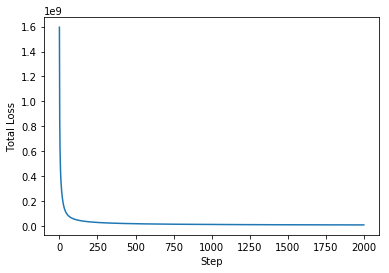

In [21]:
plt.plot(slc_1)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

(2000,)
Total loss:  18811322368.0
Weighted Content loss:  8.826979637145996
Weighted Style loss:  18811322748.66104
Time [s]:  61.266069412231445


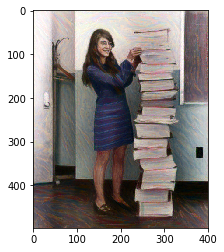

Total loss:  10596270080.0
Weighted Content loss:  9.141617774963379
Weighted Style loss:  10596269741.654396
Time [s]:  122.55641746520996


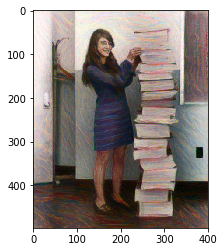

Total loss:  8270225408.0
Weighted Content loss:  9.337138175964355
Weighted Style loss:  8270225487.649441
Time [s]:  183.82101702690125


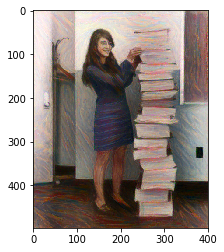

Total loss:  5959202304.0
Weighted Content loss:  9.368061065673828
Weighted Style loss:  5959202535.450459
Time [s]:  245.29475569725037


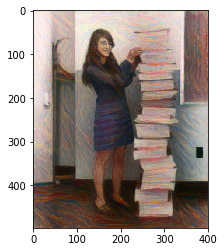

Total Time [s]:  245.42008566856384


In [22]:
# TODO Task 4: Style Transfer for content[2] and style[2] stored in target[2]
[s_2, slc_2] = run_model(vgg, layers_vgg, target[2], content_features_vgg[2], style_grams_vgg[2], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e12, steps = 2000, lr = 0.01)


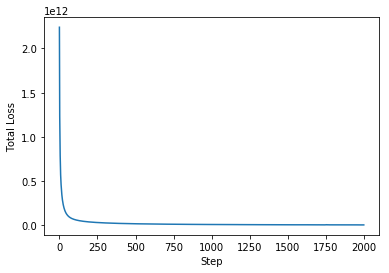

In [23]:
plt.plot(slc_2)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

(2000,)
Total loss:  1808429350912.0
Weighted Content loss:  28.8640193939209
Weighted Style loss:  1808429360389.7095
Time [s]:  67.21890497207642


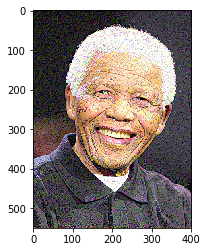

Total loss:  877994508288.0
Weighted Content loss:  29.791269302368164
Weighted Style loss:  877994537353.5156
Time [s]:  134.50905776023865


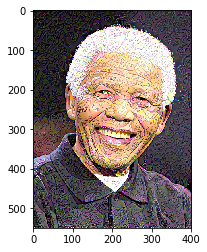

Total loss:  570962018304.0
Weighted Content loss:  30.25248908996582
Weighted Style loss:  570962011814.1174
Time [s]:  201.70626711845398


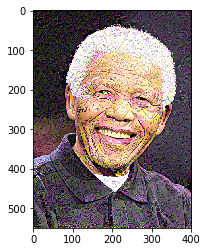

Total loss:  418748137472.0
Weighted Content loss:  30.56787872314453
Weighted Style loss:  418748140335.083
Time [s]:  279.07141733169556


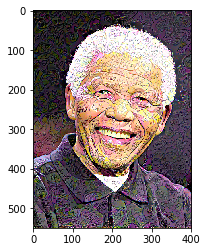

Total Time [s]:  279.2386109828949


In [24]:
# TODO Task 4: Style Transfer for content[3] and style[3] stored in target[3]
[s_3, slc_3] = run_model(vgg, layers_vgg, target[3], content_features_vgg[3], style_grams_vgg[3], 'conv4_2', style_weights_vgg, content_weight = 1, style_weight = 1.0e12, steps = 2000, lr = 0.01)

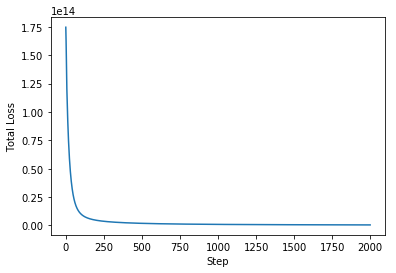

In [25]:
plt.plot(slc_3)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

In [26]:
def result_to_hd(image, filePath):
    image = im_convert(image)

    formatted = (image * 255 / np.max(image)).astype('uint8')
    pil_image = Image.fromarray(formatted, 'RGB')
    pil_image.save(filePath, "JPEG")

In [27]:
# Save results to hard disc
result_to_hd(s_0, "s0.jpg")
result_to_hd(s_1, "s1.jpg")
result_to_hd(s_2, "s2.jpg")
result_to_hd(s_3, "s3.jpg")

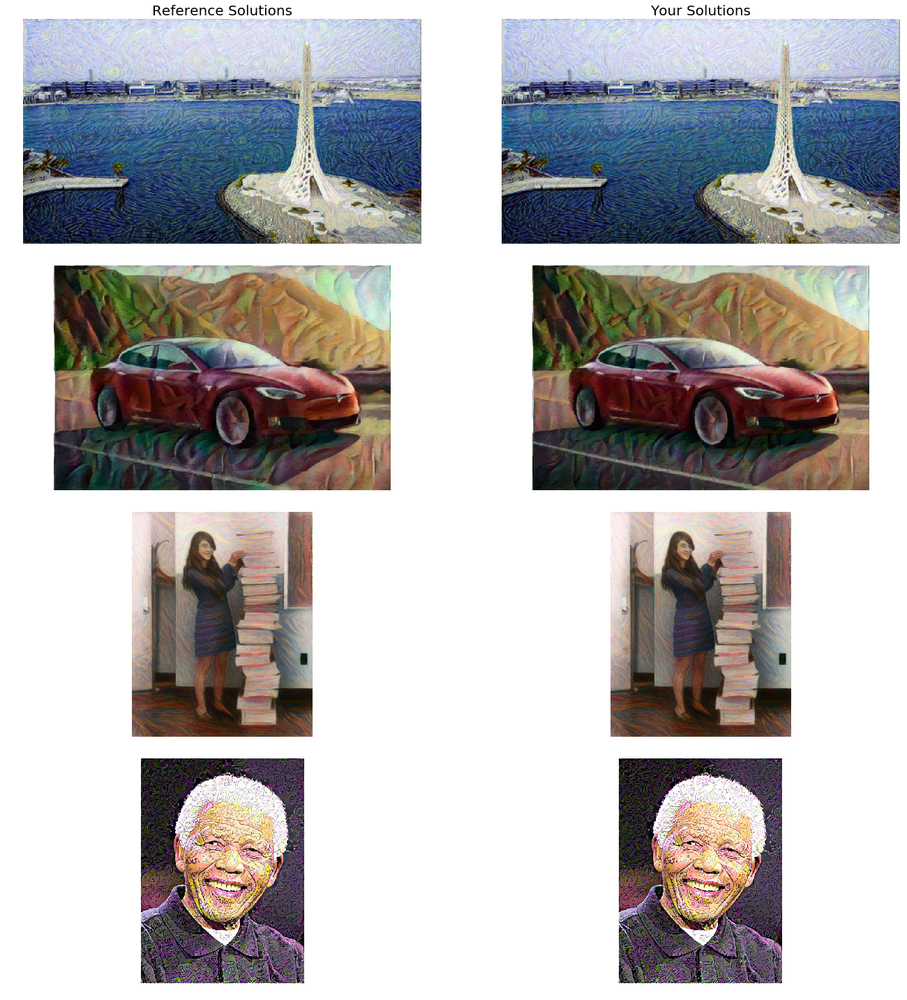

In [28]:
# Comparison to Reference Solution - Do not change anything, just execute to varify correctness of your solution

fig, axs = plt.subplots(num_pairs, 2, figsize=(20, 20))

axs[0, 0].set_title('Reference Solutions', fontsize=20)
axs[0, 1].set_title('Your Solutions', fontsize=20)

# content and correspoinding style image side-by-side
for row in range(0, num_pairs):
        axs[row, 0].imshow(im_convert(ref_vgg[row]))
        axs[row, 1].imshow(im_convert(target[row]))

        for col in range(0, 2):
            axs[row, col].axis('off')
        
fig.tight_layout()
plt.show()

# Report to task 4

<p style="color:salmon"> Report to Task 4: training parameters and final results</p>
<p style="color:salmon"> Image 1:  style_weight = 1.0e9, steps = 2000, lr = 0.01, Total Time [s]:  304.87654089927673 </p>
<p style="color:salmon"> Image 2:  style_weight = 1.0e3, steps = 2000, lr = 0.01, Total Time [s]:  287.8125424385071 </p>
<p style="color:salmon"> Image 3:  style_weight = 1.0e12, steps = 2000, lr = 0.01, Total Time [s]:  245.42008566856384 </p>
<p style="color:salmon"> Image 4: style_weight = 1.0e12, steps = 2000, lr = 0.01, Total Time [s]:  261.85149121284485 </p>
<p style="color:salmon"> After I did my first trail and tried other sets of parameters, I observed that the loss would sharply increase at the beginning and then decrease and then found out that in the code originally provided for task 4, the "target" would not be initialized every time changing the parameters, which leads to the second optimization occurs based on the previous optimization result. I added the images reloading code at the beginning of task 4. In order to get similar results to reference images, I tried to use many different sets of parameters to train the model(See the attached example parameter tuning pdf). Training the VGG model with 0.1 leanring rate for four images, the images can obtain the style generally but lose lots of details and the loss curve fluctuated severely, while when learning rate is too small, the model can only learn little features of style images. Learning rate 0.01 is kind of appropriate based on my observations. And actually when training the model first with relatively high learning rate and then with small learning rate, I got better results. </p>
<p style="color:salmon"> For the loss curves and final comparison to the reference images, please kindly see the figures above. </p>



## ResNet-18

Although the authors suggested to use the VGG net for feature extraction, we want to experiment with a different net in the next step and choose the ResNet-18 network for this purpose.

## Task 5: Apply changes to ResNet-18 (5 points) 

In [86]:
# get the resnet18 model
resnet = models.resnet18(pretrained=True).to(device)

# TODO Task 5: Remove last few layers (avgpool and fc) from resnet by substituting them with 'identity' (e.g. empty Sequential) layers
# since they are not needed and are also incompatible to the size of our input images


resnet._modules['avgpool'] = nn.Sequential()

resnet._modules['fc'] = nn.Sequential()

# freeze all resnet parameters since we're only optimizing the target image
for param in resnet.parameters():
    param.requires_grad_(False)

In [87]:
# print out ResNet-18 structure so you can see the names of various layers
print(resnet)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace)
      (conv2): Co

In [88]:
# definition of all the layers needed from resnet-18
layers_resnet = { 'conv1': 'conv1',
                 'layer1': 'conv2_x',
                 'layer2': 'conv3_x',
                 'layer3': 'conv4_x',
                 'layer4': 'conv5_x'}

In [89]:
# get content and style features only once before training
content_features_resnet = [get_features(c, resnet, layers_resnet) for c in content]
style_features_resnet = [get_features(s, resnet, layers_resnet) for s in style]

# calculate the gram matrices for each layer of our style representation
style_grams_resnet = [{layer: gram_matrix(s[layer]) for layer in s} for s in style_features_resnet]

In [90]:
# 'conv1': 1.,
style_weights_resnet = {'conv2_x': 0.8,
                        'conv3_x': 0.5,
                        'conv4_x': 0.3,
                        'conv5_x': 0.1}

## Task 6: Styler Transfer using ResNet-18 (12 points - 4 examples, 3 points each)

Experiment with different weights for style (1.0e3, 1.0e6, 1.0e9, 1.0e12), different numbers of steps (e.g. 2000, 5000, 10000) and different learning rates (e.g. 0.1, 0.01, 0.001) to find a set of parameters with which you can create a stylized image that looks similar (or preferably better) to the provided reference solution.

In [103]:
# Target Image = Content Image (Reload original images)
target = [c.clone().requires_grad_(True).to(device) for c in content]

(5000,)
Total loss:  1749702528.0
Weighted Content loss:  0.041934240609407425
Weighted Style loss:  1749702496.4541197
Time [s]:  6.237752199172974


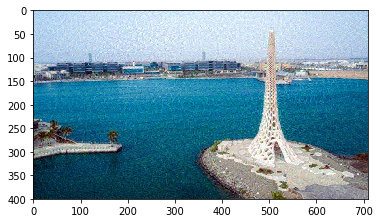

Total loss:  1266139904.0
Weighted Content loss:  0.043590109795331955
Weighted Style loss:  1266139908.6937308
Time [s]:  12.689146757125854


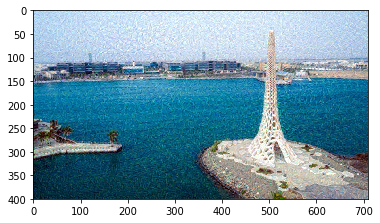

Total loss:  1054430720.0
Weighted Content loss:  0.04425257816910744
Weighted Style loss:  1054430729.7095656
Time [s]:  19.077537775039673


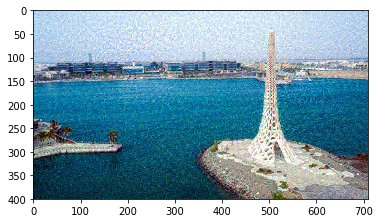

Total loss:  902272832.0
Weighted Content loss:  0.04477683827280998
Weighted Style loss:  902272819.0757334
Time [s]:  25.312409162521362


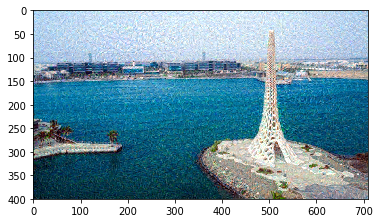

Total loss:  799018240.0
Weighted Content loss:  0.045186497271060944
Weighted Style loss:  799018249.3813336
Time [s]:  31.541337490081787


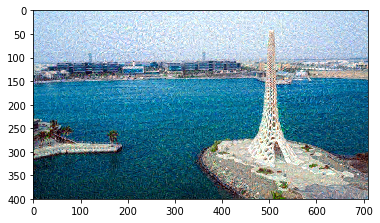

Total loss:  719454592.0
Weighted Content loss:  0.045527514070272446
Weighted Style loss:  719454605.1323414
Time [s]:  37.797218799591064


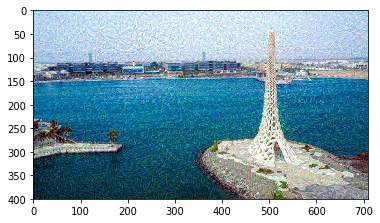

Total loss:  753207936.0
Weighted Content loss:  0.04570695385336876
Weighted Style loss:  753207947.127521
Time [s]:  44.05471110343933


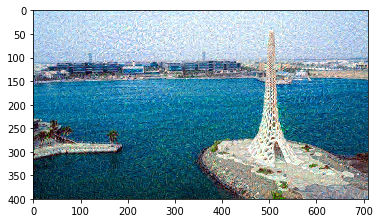

Total loss:  639058816.0
Weighted Content loss:  0.045986417680978775
Weighted Style loss:  639058824.1629303
Time [s]:  50.39271903038025


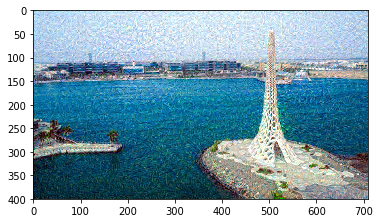

Total loss:  576382656.0
Weighted Content loss:  0.046209998428821564
Weighted Style loss:  576382677.5364578
Time [s]:  56.754228591918945


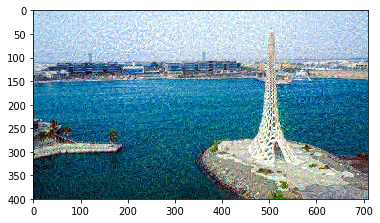

Total loss:  548952384.0
Weighted Content loss:  0.04640347510576248
Weighted Style loss:  548952375.5386472
Time [s]:  63.135292053222656


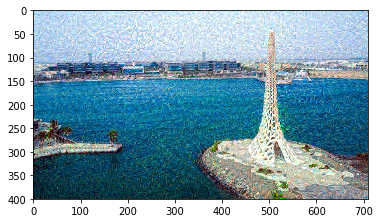

Total Time [s]:  63.31056356430054


In [104]:
# TODO Task 4: Style Transfer for content[0] and style[0] stored in target[0]
[res_0, reslc_0] = run_model(resnet, layers_resnet, target[0], content_features_resnet[0], style_grams_resnet[0], 'conv4_x', style_weights_resnet, content_weight = 1, style_weight = 1.0e12, steps = 5000, lr = 0.01)

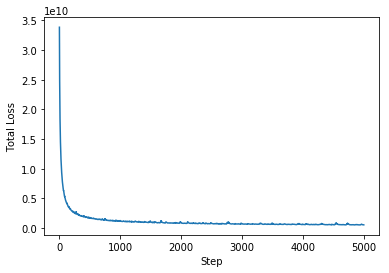

In [105]:
plt.plot(reslc_0)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

(5000,)
Total loss:  1694.859375
Weighted Content loss:  0.037557344883680344
Weighted Style loss:  1694.8217526078224
Time [s]:  6.172859191894531


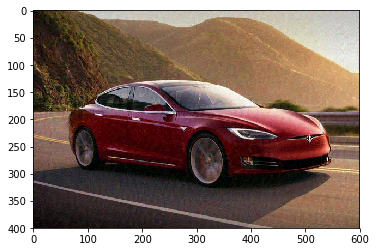

Total loss:  1276.82421875
Weighted Content loss:  0.039409831166267395
Weighted Style loss:  1276.784809306264
Time [s]:  12.56457805633545


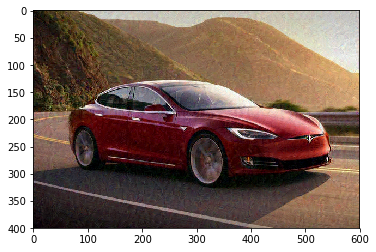

Total loss:  1109.092041015625
Weighted Content loss:  0.040312640368938446
Weighted Style loss:  1109.051750972867
Time [s]:  19.002525091171265


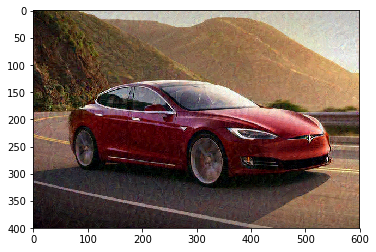

Total loss:  1001.9965209960938
Weighted Content loss:  0.04099610075354576
Weighted Style loss:  1001.9554756581783
Time [s]:  25.927536725997925


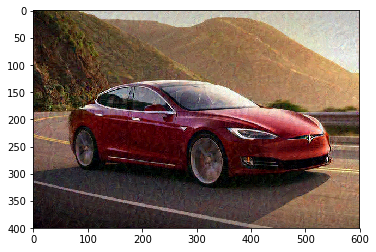

Total loss:  927.39404296875
Weighted Content loss:  0.0414249449968338
Weighted Style loss:  927.3525793105364
Time [s]:  32.94988656044006


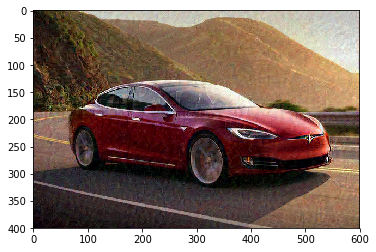

Total loss:  885.4674072265625
Weighted Content loss:  0.0418037585914135
Weighted Style loss:  885.4256011545658
Time [s]:  40.68327736854553


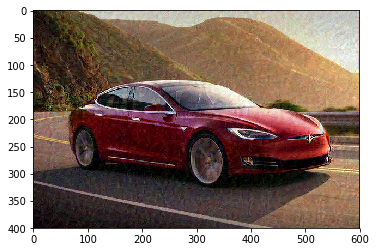

Total loss:  884.9834594726562
Weighted Content loss:  0.04221901297569275
Weighted Style loss:  884.9411970004439
Time [s]:  48.63695549964905


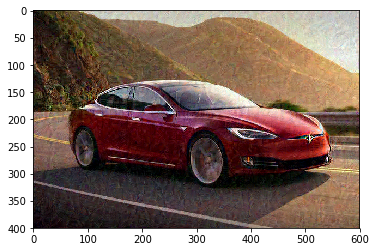

Total loss:  804.7786865234375
Weighted Content loss:  0.042414624243974686
Weighted Style loss:  804.7362789511681
Time [s]:  57.309189319610596


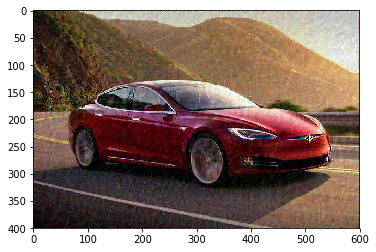

Total loss:  797.787841796875
Weighted Content loss:  0.042627494782209396
Weighted Style loss:  797.7452478371561
Time [s]:  66.02358317375183


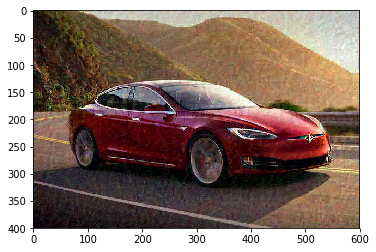

Total loss:  794.5555419921875
Weighted Content loss:  0.04288680478930473
Weighted Style loss:  794.5126271806657
Time [s]:  74.80878567695618


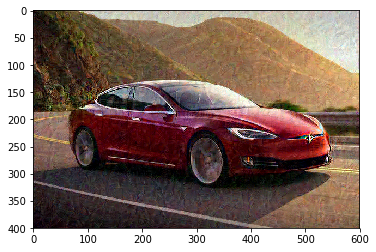

Total Time [s]:  75.00453615188599


In [106]:
# TODO Task 4: Style Transfer for content[1] and style[1] stored in target[1]
[res_1, reslc_1] = run_model(resnet, layers_resnet, target[1], content_features_resnet[1], style_grams_resnet[1], 'conv4_x', style_weights_resnet, content_weight = 1, style_weight = 1.0e6, steps = 5000, lr = 0.01)

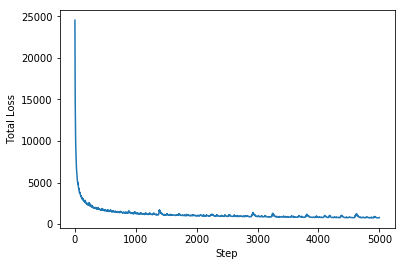

In [107]:
plt.plot(reslc_1)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

(10000,)
Total loss:  2077006976.0
Weighted Content loss:  0.03694477304816246
Weighted Style loss:  2077006967.7382708
Time [s]:  6.898769855499268


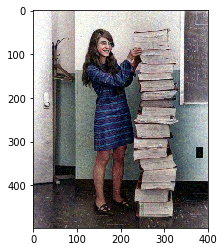

Total loss:  1434106368.0
Weighted Content loss:  0.038531310856342316
Weighted Style loss:  1434106379.7473907
Time [s]:  15.185349464416504


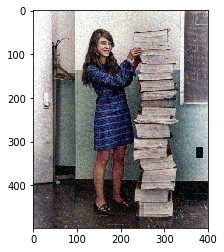

Total loss:  1198614784.0
Weighted Content loss:  0.03944024443626404
Weighted Style loss:  1198614831.0825229
Time [s]:  23.70830988883972


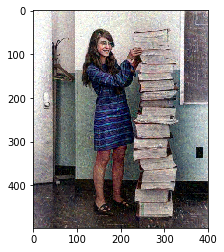

Total loss:  1087413888.0
Weighted Content loss:  0.03993610292673111
Weighted Style loss:  1087413867.9355383
Time [s]:  32.25197696685791


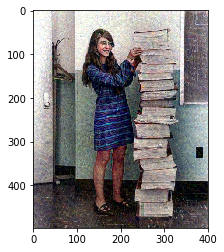

Total loss:  1069455168.0
Weighted Content loss:  0.04035571590065956
Weighted Style loss:  1069455174.729228
Time [s]:  40.71864891052246


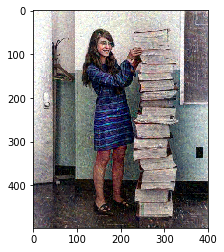

Total loss:  961049344.0
Weighted Content loss:  0.04077177494764328
Weighted Style loss:  961049343.4593081
Time [s]:  49.17284178733826


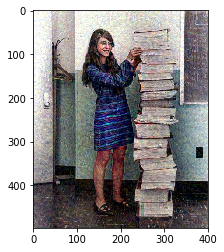

Total loss:  1029485376.0
Weighted Content loss:  0.040997009724378586
Weighted Style loss:  1029485370.9638119
Time [s]:  57.63724136352539


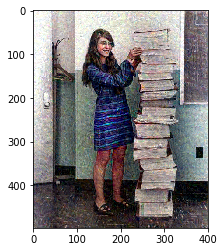

Total loss:  863866368.0
Weighted Content loss:  0.04136445000767708
Weighted Style loss:  863866356.6671312
Time [s]:  66.13993525505066


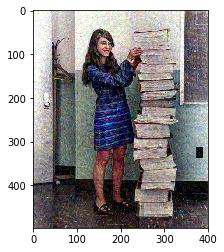

Total loss:  937791744.0
Weighted Content loss:  0.04156629741191864
Weighted Style loss:  937791774.0494013
Time [s]:  74.6515600681305


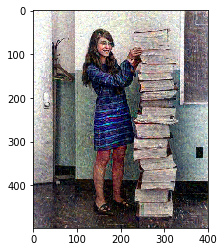

Total loss:  1062667456.0
Weighted Content loss:  0.04184823855757713
Weighted Style loss:  1062667462.9747868
Time [s]:  83.08920764923096


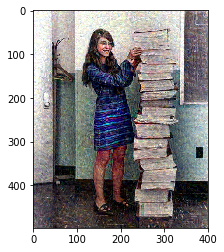

Total loss:  779996672.0
Weighted Content loss:  0.04199929162859917
Weighted Style loss:  779996684.2867434
Time [s]:  91.46032571792603


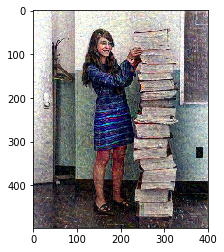

Total loss:  780263424.0
Weighted Content loss:  0.04212508723139763
Weighted Style loss:  780263449.9967098
Time [s]:  99.87608480453491


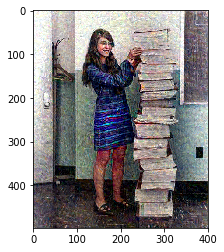

Total loss:  765561920.0
Weighted Content loss:  0.04224853590130806
Weighted Style loss:  765561941.0797954
Time [s]:  108.21971559524536


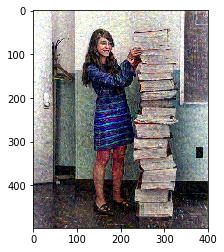

Total loss:  823394048.0
Weighted Content loss:  0.04241381213068962
Weighted Style loss:  823394046.1650491
Time [s]:  116.56865215301514


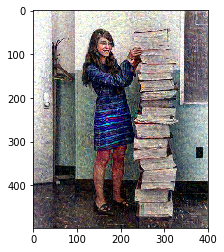

Total loss:  696621632.0
Weighted Content loss:  0.04255368188023567
Weighted Style loss:  696621660.6087983
Time [s]:  124.89941263198853


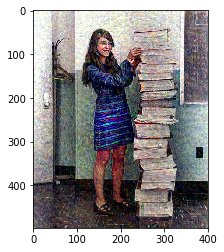

Total loss:  684881920.0
Weighted Content loss:  0.042675722390413284
Weighted Style loss:  684881932.1021438
Time [s]:  132.0657172203064


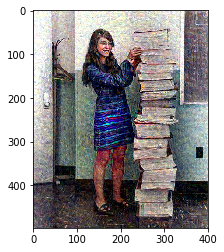

Total loss:  703492800.0
Weighted Content loss:  0.04275302588939667
Weighted Style loss:  703492783.9413285
Time [s]:  139.2167637348175


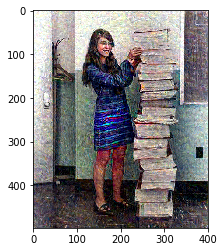

Total loss:  667233984.0
Weighted Content loss:  0.042825184762477875
Weighted Style loss:  667234009.5974505
Time [s]:  146.45691967010498


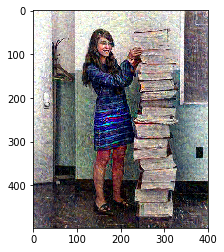

Total loss:  671907328.0
Weighted Content loss:  0.04283304139971733
Weighted Style loss:  671907328.06921
Time [s]:  153.7566375732422


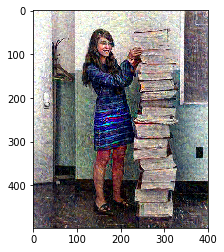

Total loss:  739046976.0
Weighted Content loss:  0.04294980689883232
Weighted Style loss:  739046954.549849
Time [s]:  160.92442226409912


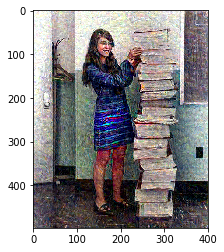

Total Time [s]:  161.06547331809998


In [108]:
# TODO Task 4: Style Transfer for content[2] and style[2] stored in target[2]
[res_2, reslc_2] = run_model(resnet, layers_resnet, target[2], content_features_resnet[2], style_grams_resnet[2], 'conv4_x', style_weights_resnet, content_weight = 1, style_weight = 1.0e12, steps = 10000, lr = 0.01)

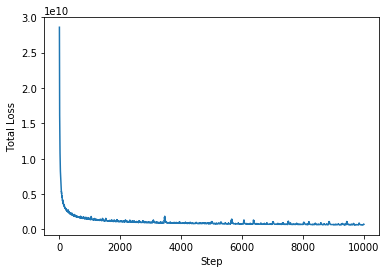

In [109]:
plt.plot(reslc_2)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

(5000,)
Total loss:  2196772864.0
Weighted Content loss:  0.04226845130324364
Weighted Style loss:  2196772955.3580284
Time [s]:  8.475922107696533


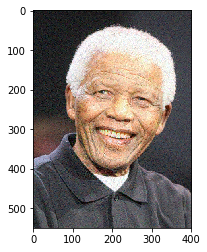

Total loss:  1496187648.0
Weighted Content loss:  0.04353778064250946
Weighted Style loss:  1496187644.0793276
Time [s]:  17.93433380126953


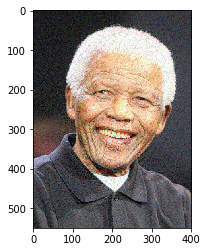

Total loss:  1300072064.0
Weighted Content loss:  0.04415488988161087
Weighted Style loss:  1300072064.6232367
Time [s]:  27.438271522521973


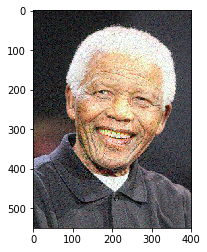

Total loss:  1132699392.0
Weighted Content loss:  0.044715940952301025
Weighted Style loss:  1132699428.126216
Time [s]:  36.88900852203369


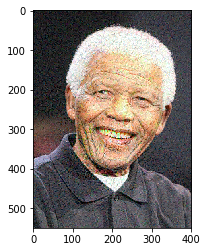

Total loss:  996214016.0
Weighted Content loss:  0.045005712658166885
Weighted Style loss:  996213988.4009957
Time [s]:  46.378631591796875


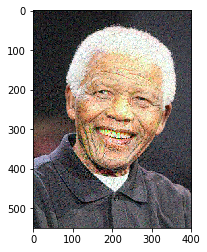

Total loss:  1045097216.0
Weighted Content loss:  0.045163676142692566
Weighted Style loss:  1045097247.697413
Time [s]:  55.715850591659546


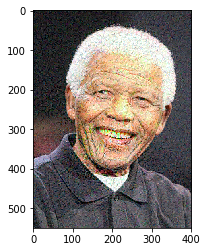

Total loss:  869836352.0
Weighted Content loss:  0.04533319175243378
Weighted Style loss:  869836367.20106
Time [s]:  65.20431327819824


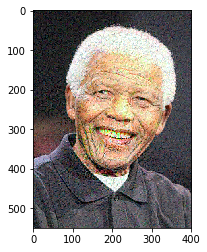

Total loss:  839543104.0
Weighted Content loss:  0.045527130365371704
Weighted Style loss:  839543121.4012206
Time [s]:  76.15722465515137


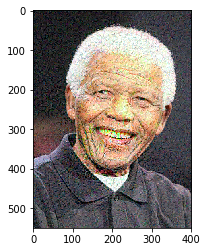

Total loss:  793546560.0
Weighted Content loss:  0.04565072059631348
Weighted Style loss:  793546554.6324849
Time [s]:  84.44657254219055


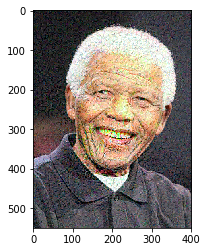

Total loss:  765166336.0
Weighted Content loss:  0.04580383002758026
Weighted Style loss:  765166361.8162274
Time [s]:  93.1382520198822


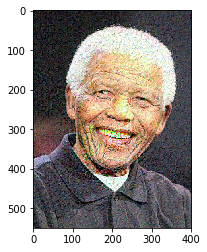

Total Time [s]:  93.2737250328064


In [110]:
# TODO Task 4: Style Transfer for content[3] and style[3] stored in target[3]
[res_3, reslc_3]  = run_model(resnet, layers_resnet, target[3], content_features_resnet[3], style_grams_resnet[3], 'conv4_x', style_weights_resnet, content_weight = 1, style_weight = 1.0e12, steps = 5000, lr = 0.01)


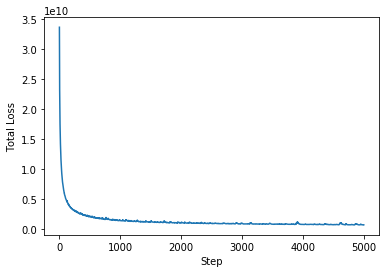

In [111]:
plt.plot(reslc_3)
plt.xlabel('Step')
plt.ylabel('Total Loss')
plt.show()

In [112]:
# Save results to hard disc
result_to_hd(res_0, "res0_reference.jpg")
result_to_hd(res_1, "res1_reference.jpg")
result_to_hd(res_2, "res2_reference.jpg")
result_to_hd(res_3, "res3_reference.jpg")

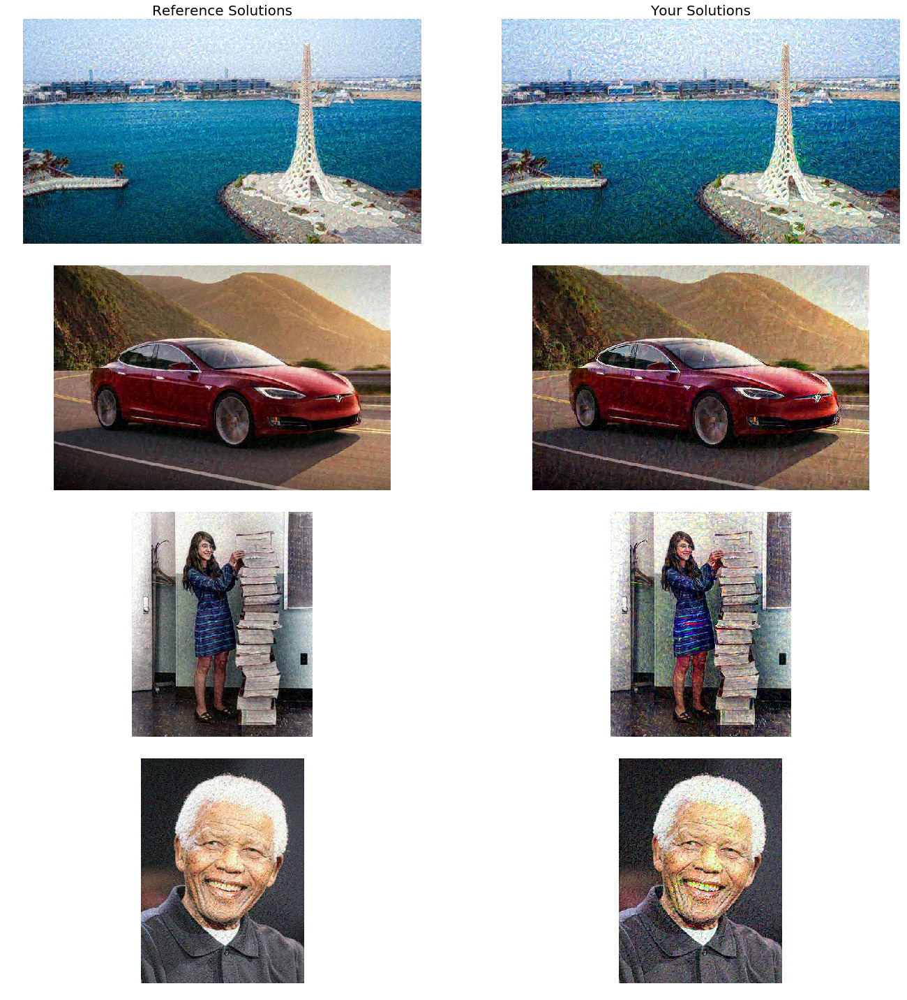

In [114]:
# Comparison to Reference Solution - Do not change anything, just execute to varify correctness of your solution

fig, axs = plt.subplots(num_pairs, 2, figsize=(20, 20))

axs[0, 0].set_title('Reference Solutions', fontsize=20)
axs[0, 1].set_title('Your Solutions', fontsize=20)

# content and correspoinding style image side-by-side
for row in range(0, num_pairs):
        axs[row, 0].imshow(im_convert(ref_res[row]))
        axs[row, 1].imshow(im_convert(target[row]))

        for col in range(0, 2):
            axs[row, col].axis('off')
        
fig.tight_layout()
plt.show()

# Report to Task 5

<p style="color:salmon"> Report to Task 5: training parameters and final results</p>
<p style="color:salmon"> Image 1: style_weight = 1.0e12, steps = 5000, lr = 0.01, Total Time [s]:  63.31056356430054 </p>
<p style="color:salmon"> Image 2: style_weight = 1.0e6, steps = 10000, lr = 0.01, Total Time [s]:  75.00453615188599 </p>
<p style="color:salmon"> Image 3:  style_weight = 1.0e12, steps = 5000, lr = 0.01, Total Time [s]:  161.06547331809998</p>
<p style="color:salmon"> Image 4: style_weight = 1.0e12, steps = 5000, lr = 0.01, Total Time [s]:  93.2737250328064  </p>

<p style="color:salmon"> For the loss curves and final comparison to the reference images, please kindly see the figures above. </p>

<p style="color:salmon"> Basically, using ResNet, it is much faster than using VGG but it is really hard to get good results even though I have tried many different parameters. </p>


## Task 6.1: Conclusion
What is the difference between the style transfer results when using VGG or ResNet? Add a short conclusion to your final report.

# Deep Correlations for Texture synthesis [2]

The paper [2] presents a texture synthesis technique that builds upon convolutional neural networks and extracted statistics of pre-trained deep features. The main contribution is the introduction of *deep correlation matrices* that allow the synthesis of textures that not only resemble local but also global structure of an example image.

## Task 7: VGG Layer Replacement (5 points)

The authors of [2] suggest to replace all MaxPool layers with Averaging layers for better results. This should be done in the cell below.

In [21]:
# Replace MaxPool Layers in VGG19 network with average pooling layers

# TODO Task 7: Identify maxpool layer indices
maxpool_idx = [4,9,18,27,36]

for i in maxpool_idx:
    # TODO Task 7: Replace maxpool layer with averaging layer (kernel_size = 2, stride = 2)
    vgg[i] = nn.AvgPool2d(kernel_size = 2, stride = 2)

In [22]:
# Define the layers from which the features are extracted

layers_deepcorr = {'0': 'conv1',
                   '4': 'pool1',
                   '9': 'pool2', 
                  '18': 'pool3', 
                  '27': 'pool4'}  ## content representation

## Task 8: Implement the computation of the deep correlation matrices $R^{l,n}_{i,j}$ for a given tensor representing layer $l$ as decribed in [2] (10 points)

Note that the computation of $R^{l,n}_{i,j}$ requires a convolution (or more correctly, a cross-correlation) of each feature map with itself. Instead of trying to implement this convolution using nested `for` loops, use the `nn.Conv2d` module for performance reasons. Do not forget to use appropriate zero-padding that allows an output size equal to `output_size` and to set `bias=False`. Further do not forget to compute appropriate weights $w_{i,j}$.

In [23]:
import math
def deep_corr_matrix_stack(tensor, output_size = None):
    """ Calculate the set of Deep Correlation Matrices for a given tensor as described in [2]
    """
    
    # TODO Task 8: implement the computation of the deep correlation matrices
    b, d, Q, M = tensor.size()
 
    #tensor = torch.randn((100,100,101,100))

    QQ = math.floor(Q/2)
    MM = math.floor(M/2) 
    i = torch.arange(-QQ, QQ+1).view(1,1,2*QQ+1,1)
    j = torch.arange(-MM, MM+1).view(1,1,1,2*MM+1)
    weights = 1 / ((Q - torch.abs(i)) * (M - torch.abs(j))).float().cuda()
    #plt.imshow(weights.squeeze())
    #plt.colorbar()
    
    assert b == 1
    corr = nn.functional.conv2d(input = tensor, weight = tensor.view(d,1,Q,M), padding = (QQ, MM), groups =d)
    
    deep_corr = corr * weights
    
    
    return deep_corr

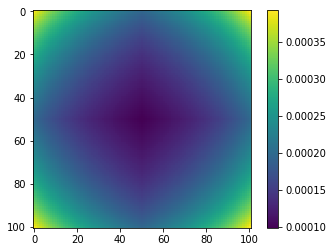

In [28]:
# the plot of the weights: plt.imshow(weights.squeeze())
tensor = torch.randn(100,100,100,100)

## Task 9: Implement the computation of the smoothness loss $E^l_{smooth}$ for a given tensor representing layer $l$ as decribed in [2] (10 points)

Note that Equation 10 defining $E^l_{smooth}$ in the paper [2] is missing an important factor for the sum of exponentials. Please refer to Appendix B for the correct version that directly reflects the equation as it was also implemented by the authors. Further note that the equation implicitly requires each pixel to have exactly 4 neighbors in its 4-connected neighborhood. We therefore have two options to handle boarder pixels:

* If we access an index beyond the image limits, we access the pixel on the opposite image boarder (`circ = True`).
* The pixel values of non-existing neighbors beyond the image limits are assumed to have value 0 (`circ = False`). 

You can experiment with both versions, but you only have to implement one to get full points.

In [24]:
def E_smooth(tensor, sigma = 0.001, circ = True):
    
    # get the batch_size, depth, height, and width of the Tensor
    _, d, Q, M = tensor.size()
    
    # TODO Task 8: Implement the computation of E^l_{smooth}

    e_smooth = 0
    for i in range(d) :
        
        # torch.roll is a funciton to Roll the tensor along the given dimension(s). 
        # Elements that are shifted beyond the last position are re-introduced at the first position.
        smoothness_1 = tensor - tensor.roll(shifts = -1, dims = 2)
        smoothness_2 = tensor - tensor.roll(shifts =  1, dims = 2)
        smoothness_3 = tensor - tensor.roll(shifts = -1, dims = 3)
        smoothness_4 = tensor - tensor.roll(shifts =  1, dims = 3)

        e_smooth = e_smooth + ( 1/2 * sigma * torch.sum(torch.log(
            0.25 * torch.exp(-sigma * (smoothness_1)**2) +\
            0.25 * torch.exp(-sigma * (smoothness_2)**2) +\
            0.25 * torch.exp(-sigma * (smoothness_3)**2) +\
            0.25 * torch.exp(-sigma * (smoothness_4)**2) )) )
        

    return e_smooth

In [25]:
def white_gauss_noise(size, mu = 0, sigma = 1.0e-3):
    m = torch.distributions.normal.Normal(mu, sigma)
    return m.sample(size)

In [26]:
''' Define and load texture files '''

texture_files = ['Texture13', 'Texture25', 'Texture62', 'Texture115']
ref_tex_files = ['tex0_ref', 'tex1_ref', 'tex2_ref', 'tex3_ref']

# load in texture images
texture_size = 225
texture = [load_image('img/texture/' + t + '.png', texture_size).to(device) for t in texture_files]

ref_tex = [load_image('img/ref/' + t + '.jpg', texture_size).to(device) for t in ref_tex_files]

target = [white_gauss_noise((t.shape[0], t.shape[1], t.shape[2], t.shape[3]), mu = 0, sigma = 0.01).to(device).requires_grad_(True) for t in texture]

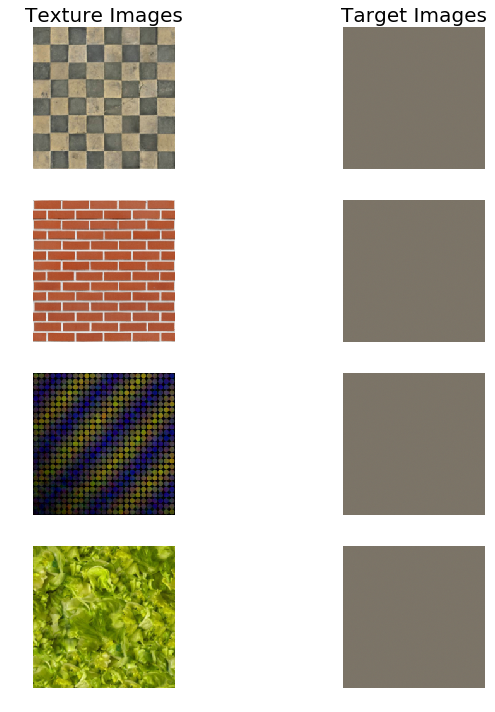

In [27]:
# display the images
num_textures = len(texture)
fig, axs = plt.subplots(num_pairs, 2, figsize=(10, 10))

axs[0, 0].set_title('Texture Images', fontsize=20)
axs[0, 1].set_title('Target Images', fontsize=20)

# content and correspoinding style image side-by-side
for row in range(0, num_pairs):
        axs[row, 0].imshow(im_convert(texture[row]))
        axs[row, 1].imshow(im_convert(target[row]))

        for col in range(0, 2):
            axs[row, col].axis('off')
        
fig.tight_layout()
plt.show()

In [28]:
# weights and parameters (cf. Table 1 in the paper [2])

# alpha, beta, gamma and delta corresponding to the loss weights for E_Grm, E_DCor, E_Div and E_Smooth
alpha = 0.5
beta = 0.5
gamma = -1.0e-4
delta = -0.75e-3

gram_layer_weights = {'pool1': 0.25,
                      'pool2': 0.25,
                      'pool3': 0.25,
                      'pool4': 0.25}

dcor_layer_weights = {'pool2': 1}
div_layer_weights = {'pool2': 1}
smooth_layer_weights = {'conv1': 1}

sigma = 1.0e-3

In [29]:
# get texture features only once before training
texture_features = [get_features(t, vgg, layers_deepcorr) for t in texture]
#style_features = [get_features(s, vgg) for s in style]

# calculate gram matrices G
texture_grams = [{layer: gram_matrix(t[layer]) for layer in t if layer in gram_layer_weights} for t in texture_features]

# calculate deep correlation matrices R
texture_dcors = [{layer: deep_corr_matrix_stack(t[layer]) for layer in t if layer in dcor_layer_weights} for t in texture_features]

# pick features for E_Div
texture_divs = [{layer: t[layer] for layer in t if layer in div_layer_weights} for t in texture_features]

# pick features for E_Smooth
texture_smooths = [{layer: t[layer] for layer in t if layer in smooth_layer_weights} for t in texture_features]

## Task 10: Texture Synthesis Function (10 points - 4 examples, 2.5 points each)

Complete the texture synthesis function below. Note that we do not use the Adam optmizer this time but LBFGS.

In [33]:
def texture_synthesis_lbfgs(tex_idx, lr = 1):

    # for displaying the target image, intermittently
    save_every = 10
    print_every = 10
    
    def closure():

        # get the features from your target image
        target_features = get_features(target[tex_idx], vgg, layers_deepcorr)

        # E_Grm
        E_Grm = 0
        if alpha != 0:
            for layer in gram_layer_weights:
                target_feature = target_features[layer]
                _, d, Q, M = target_feature.size()
                
                # TODO Task 10: Compute E_l_Grm as defined in [2]
                target_gram = gram_matrix(target_feature)
                texture_gram = texture_grams[tex_idx][layer]
                E_l_Grm = (1/ (2*Q*M)**2 ) * (torch.sum((texture_gram - target_gram)**2))
                
                E_Grm = E_Grm + gram_layer_weights[layer] * E_l_Grm
                
        # E_DCor
        E_DCor = 0
        if beta != 0:
            for layer in dcor_layer_weights:
                target_feature = target_features[layer]
                _, d, Q, M = target_feature.size()

                # TODO Task 10: Compute E_l_Dcor as defined in [2]
                target_dcor = deep_corr_matrix_stack(target_feature, output_size = None)
                texture_dcor = texture_dcors[tex_idx][layer]
                E_l_Dcor = (torch.sum((texture_dcor - target_dcor)**2)) / 4

                E_DCor = E_DCor + dcor_layer_weights[layer] * E_l_Dcor
    
        # E_Div
        E_Div = 0
        if gamma != 0:
            for layer in div_layer_weights:
                target_feature = target_features[layer]
                _, d, Q, M = target_feature.size()
                
                # TODO Task 10: Compute E_l_Div as defined in [2]
                target_div = target_feature
                texture_div = texture_divs[tex_idx][layer]
                E_l_Div = (torch.sum((texture_div - target_div)**2)) / 2

                E_Div = E_Div + div_layer_weights[layer] * E_l_Div

        # E_Smooth
        E_Smooth = 0
        if delta != 0:
            for layer in smooth_layer_weights:
                
                # TODO Task 10: Compute E_l_Smooth as shown in Appendix B
                E_l_Smooth = E_smooth(target_features[layer]) 

                E_Smooth = E_Smooth + smooth_layer_weights[layer] * E_l_Smooth

        # calculate the *total* loss
        
        # TODO Task 10: Compute the total loss as defined in [2] and shown in Appendix B
        total_loss = alpha * E_Grm + beta * E_DCor + gamma * E_Div + delta * E_Smooth
        # print(E_Grm.shape, E_DCor.shape, E_Div.shape, E_Smooth.shape)

        # update your target image
        optimizer.zero_grad()
        total_loss.backward()
        # optimizer.step()
        return total_loss

    # iteration hyperparameters
    start = time.time()
    
    # Similar to the reference implementation by the authors of [2], we use LBFGS this time to optimize our texture
    
    # torch.optim.LBFGS(params, lr=1, max_iter=20, max_eval=None, tolerance_grad=1e-05, tolerance_change=1e-09, history_size=100, line_search_fn=None)
    optimizer = optim.LBFGS([target[tex_idx]], lr=lr, max_iter=300)
    optimizer.step(closure)

    end = time.time()
    print('Total Time [s]: ', (end - start))
    
    return target[tex_idx]

In [34]:
# Reset Targets to Noise if they have changed

target = [white_gauss_noise((t.shape[0], t.shape[1], t.shape[2], t.shape[3]), mu = 0, sigma = 0.001).to(device).requires_grad_(True) for t in texture]

## Task 11: Texture Synthesis (5 points, 1.25 points each)
Test you implementation for texture synthesis on four examples. Report the total time for synthesis together with the results.

<p style="color:salmon"> Report to Task 11: training total time is 723.81</p>


In [35]:
# Texture Synthesis of a texture that is similar to target[0]
tex_0 = texture_synthesis_lbfgs(0)

Total Time [s]:  173.93249249458313


In [37]:
# Texture Synthesis of a texture that is similar to target[1]
tex_1 = texture_synthesis_lbfgs(1)

Total Time [s]:  135.55422067642212


In [38]:
# Texture Synthesis of a texture that is similar to target[2]
tex_2 = texture_synthesis_lbfgs(2)

Total Time [s]:  208.50326132774353


In [39]:
# Texture Synthesis of a texture that is similar to target[3]
tex_3 = texture_synthesis_lbfgs(3)

Total Time [s]:  205.83066964149475


In [43]:
# Save results to hard disc
result_to_hd(tex_0, "tex0_ref.jpg")
result_to_hd(tex_1, "tex1_ref.jpg")
result_to_hd(tex_2, "tex2_ref.jpg")
result_to_hd(tex_3, "tex3_ref.jpg")

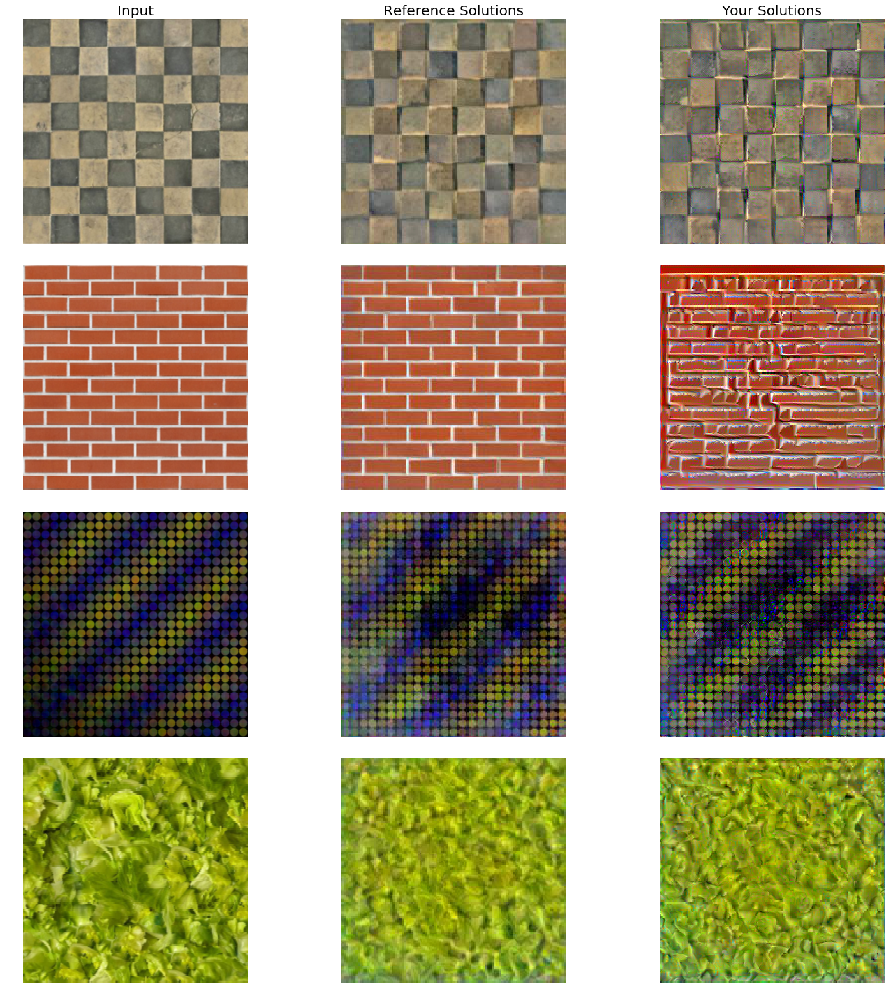

In [41]:
# Comparison to Reference Solution - Do not change anything, just execute to varify correctness of your solution

fig, axs = plt.subplots(num_pairs, 3, figsize=(20, 20))

axs[0, 0].set_title('Input', fontsize=20)
axs[0, 1].set_title('Reference Solutions', fontsize=20)
axs[0, 2].set_title('Your Solutions', fontsize=20)

# content and correspoinding style image side-by-side
for row in range(0, num_pairs):
        axs[row, 0].imshow(im_convert(texture[row]))
        axs[row, 1].imshow(im_convert(ref_tex[row]))
        axs[row, 2].imshow(im_convert(target[row]))

        for col in range(0, 3):
            axs[row, col].axis('off')
        
fig.tight_layout()
plt.show()

## Useful Commands
* For the computation of the gram matrix a stretching of each 2d activation map into a vector is required, this can be easily done by applying the [torch.Tensor.view](https://pytorch.org/docs/stable/tensors.html#torch.Tensor.view) command.
* The transpose of a torch matrix can be obtained using [torch.Tensor.transpose](https://pytorch.org/docs/stable/tensors.html?#torch.Tensor.transpose)
* Two torch matrices (tensors with 2 dimensions, a height and a width) can be multiplied using [torch.mm](https://pytorch.org/docs/stable/torch.html#torch.mm)
* The scalar mean of an arbitrary shaped tensor can be computed using [torch.mean](https://pytorch.org/docs/stable/torch.html#torch.mean)
* The dimensionality of a tensor (`batch_size`, `num_channels`, `height`, `width`) can be queried using [torch.Tensor.size](https://pytorch.org/docs/stable/tensors.html?highlight=size#torch.Tensor.size)
* A subsection of a Pytorch tensor can be obtained by using the [torch.narrow](https://pytorch.org/docs/stable/torch.html#torch.narrow) command or by referring to the desired subsection with a command similar to `tensor[:, :, 1:, :]`. In this example, one would obtain a slice with the first index of the third dimension removed.

## References


[1]	Gatys, Ecker, and Bethge, “Image Style Transfer Using Convolutional Neural Networks”,
CVPR 2016, [Paper](https://ieeexplore.ieee.org/document/7780634)

[2]	Sendik, and Cohen-Or, “Deep Correlations for Texture synthesis”, Siggraph 2017, [Paper](https://dl.acm.org/citation.cfm?id=3015461)

[3]	torchvision.models, https://pytorch.org/docs/stable/torchvision/models.html

[4]	Gramian Matrix, https://en.wikipedia.org/wiki/Gramian_matrix

## Appendix A - Details of [1]

Let $N_l$ be the number of feature maps at layer $l$ and let $M_l$ be the number of scalar values in each feature map, hence the height times the width of each feature map at layer $l$. By stretching the $2d$ responses in each feature map into a $1d$ vector, the responses at layer $l$ can therefore be stored in a matrix $F^l \in \mathbb{R}^{N_l \times M_l}$ where $F^l_{ij}$ is the activation value of the $i^{th}$ filter at position $j$ in layer $l$. Let further be $P^l$ and $F^l$ the feature representations of the content image $\vec{p}$ and the target image $\vec{x}$ in layer $l$ respectively.

#### Content Loss

Since we want to keep the content of $\vec{p}$ in our target image $\vec{x}$, it is a reasonable choice to minimize the squared difference between their corresponding activations $P^l$ and $F^l$. Recall that in higher layers of a neural network, detailed pixel information about the input image is usually lost, while information about the high-level content is preserved. In order to preserve the content it is therefore a good idea to choose a layer number corresponding to one of the higher layers $l$ (e.g. corresponding to `conv4_2` in VGG19) to define the content loss $\mathcal{L}_{\textrm{content}}$:


$$ \mathcal{L}_{\textrm{content}} \left( \vec{p}, \vec{x},l \right) = \frac{1}{N_l M_l} \sum_{i,j} \left( F^l_{ij} - P^l_{ij} \right)^2 = \textrm{mean}\left( \left( F^l - P^l \right) \odot \left( F^l - P^l \right) \right)$$

Note that this definition is slightly different from the original paper [1]. It is however highly recommended to take the mean of the sum of squares to be independet to the extent of the respective layer $l$.

##### Gram matrix

In order to preserve the style of the style image a we can not directly compare the feature maps of $\vec{a}$ and $\vec{x}$, but we can (as described in [1]) compare feature correlations which are given by the Gram matrix [4] $G^l \in \mathbb{R}^{N_l \times N_l}$ where $G^l_{ij}$ is the inner product between the vectorised feature maps $i$ and $j$ in layer $l$:

$$G^l_{ij} = \sum_{k} F^l_{ik} F^l_{jk}$$

#### Style Loss

We obtain a multi-scale representation of the style image by taking several layers l into account. Let $A^l$ and $G^l$ be the style representations (given by the corresponding Gram matrix) of the style image $\vec{a}$ and the target image $\vec{x}$ respectively, the contribution of layer $l$ to the style loss can then be defined as

$$ E_l = \frac{1}{N^2_l M^2_l} \sum_{i,j} \left( G^l_{ij} - A^l_{ij} \right)^2 = \frac{1}{M_l^2} \textrm{mean}\left( \left( G^l - A^l \right) \odot \left( G^l - A^l \right) \right) $$

Note that this definition of the style loss is also a bit different from from the paper.

By choosing a suitable weight $w_l$ for each layer $l$ we obtain the style loss $\mathcal{L}_{\textrm{style}}$ as

$$ \mathcal{L}_{\textrm{style}} \left( \vec{a}, \vec{x} \right) = \sum_{l=0}^{L} w_l E_l $$

The total loss is simply a weighted sum of the content loss and the style loss:

$$ \mathcal{L}_{\textrm{total}} \left( \vec{p}, \vec{a}, \vec{x} \right) = \alpha \mathcal{L}_{\textrm{content}} \left( \vec{p}, \vec{x} \right) + \beta \mathcal{L}_{\textrm{style}} \left( \vec{a}, \vec{x} \right) $$

Although this has not to be done in code explicitly, it is highly recommended to verify that the necessary gradients $\frac{\partial \mathcal{L}_{\textrm{content}}}{\partial F^l_{ij}}$ and $\frac{\partial E_l}{\partial F^l_{ij}}$, both with respect to the activations in the layer $l$, can be analytically derived as

$$\frac{\partial \mathcal{L}_{\textrm{content}}}{\partial F^l_{ij}} = \begin{cases} \begin{array}{lr} \frac{2}{N_l M_l} \left( F^l - P^l \right)_{ij} & \textrm{if} \; F^l_{ij}>0 \\ 0 & \textrm{if} \; F^l_{ij} \leq 0 \end{array} \end{cases}$$

$$\frac{\partial E_l}{\partial F^l_{ij}} = \begin{cases} \begin{array}{lr} \frac{2}{N_l^2 M^2_l} \left( \left( F^l \right)^T \left( G^l - A^l \right) \right)_{ji} & \textrm{if} \; F^l_{ij}>0 \\ 0 & \textrm{if} \; F^l_{ij} \leq 0 \end{array} \end{cases}$$

## Appendix B - Details of [2]

The approach presented in [2] is very similar to the method proposed in [1], the main contribution is the computation of the *deep correlation matrices* to obtain results that are similar to the input image both on a local and a global scale. For completeness (and in the case of $E^l_{smooth}$ for error correction), the essential equations of the proposed method are presented in the following.

$$E^l_{smooth} = \frac{1}{2 \sigma} \sum_{i,j,n} \textrm{log} \left( \frac{1}{4} \sum_{\delta i, \delta j} \textrm{exp} \left( -\sigma \cdot \left( f^{l,n}_{i,j} - f^{l,n}_{i + \delta i, j + \delta j} \right)^2 \right) \right)$$

$$E_{smooth} = \sum_{l} w^S_l E^l_{Smoooth}$$